# EDA

In [1]:
import pandas as pd

### Properati

**Properati.com** es una plataforma en web y móvil para el mercado inmobiliario en Latam, parte de OLX Group. Quienes busquen un nuevo hogar o quieran invertir en propiedades encontrarán en Properati, además de las ofertas disponibles, valiosa información para tomar las mejores decisiones: promedios de precios, características de los barrios, comparaciones, etc.



In [241]:
dataset = pd.read_csv("ar_properties.csv") #https://www.properati.com.ar/data/ (SOLO ARGENTINA)

In [242]:
dataset[dataset.columns[:20]].head()

,id,ad_type,start_date,end_date,created_on,lat,lon,l1,l2,l3,l4,l5,l6,rooms,bedrooms,bathrooms,surface_total,surface_covered,price,currency
0,DyVXfkpKygVBKuUk5olH+A==,Propiedad,2020-08-22,2020-09-03,2020-08-22,-34.407468,-58.957367,Argentina,Bs.As. G.B.A. Zona Norte,Pilar,NaN,NaN,NaN,NaN,NaN,NaN,133139.0,NaN,NaN,NaN
1,9naojilaMecJN4jlQiTkGg==,Propiedad,2020-08-22,2020-09-04,2020-08-22,-37.996039,-57.542509,Argentina,Buenos Aires Costa Atlántica,Mar del Plata,NaN,NaN,NaN,8.0,NaN,NaN,687.0,687.0,NaN,NaN
2,tlCPRJPjoDEUzuuCelemAQ==,Propiedad,2020-08-22,2020-08-31,2020-08-22,-31.380187,-58.009182,Argentina,Entre Ríos,Concordia,NaN,NaN,NaN,2.0,1.0,1.0,80.0,80.0,NaN,NaN
3,Zw3b91glQUO3HNrM5fPYlQ==,Propiedad,2020-08-22,2020-09-04,2020-08-22,-27.494106,-55.123455,Argentina,Misiones,Oberá,NaN,NaN,NaN,2.0,1.0,1.0,NaN,NaN,NaN,NaN
4,bsU81gm9JEgtZCbTYgvykg==,Propiedad,2020-08-22,2020-09-04,2020-08-22,-32.948856,-60.630464,Argentina,Santa Fe,Rosario,NaN,NaN,NaN,3.0,1.0,1.0,76.0,66.0,NaN,NaN


## Esquema de avisos
- **type** - Tipo de aviso (Propiedad, Desarrollo/Proyecto).
- **country** - País en el que está publicado el aviso (Argentina, Uruguay, Colombia, Ecuador, Perú)
- **id** - Identificador del aviso. No es único: si el aviso es actualizado por la inmobiliaria (nueva versión del aviso) se crea un nuevo registro con la misma id pero - distintas fechas: de alta y de baja.
- **start_date** - Fecha de alta del aviso.
- **end_date** - Fecha de baja del aviso.
- **created_on** - Fecha de alta de la primera versión del aviso.
- **place** - Campos referidos a la ubicación de la propiedad o del desarrollo.
- **lat** - Latitud.
- **lon** - Longitud.
- **l1** - Nivel administrativo 1: país.
- **l2** - Nivel administrativo 2: usualmente provincia.
- **l3** - Nivel administrativo 3: usualmente ciudad.
- **l4** - Nivel administrativo 4: usualmente barrio.
- **property** - Campos relativos a la propiedad (vacío si el aviso es de un desarrollo/proyecto).
- **operation** - Tipo de operación (Venta, Alquiler).
- **type** - Tipo de propiedad (Casa, Departamento, PH).
- **rooms** - Cantidad de ambientes (útil en Argentina).
- **bedrooms** - Cantidad de dormitorios (útil en el resto de los países).
- **bathrooms** - Cantidad de baños.
- **surface_total** - Superficie total en m².
- **surface_covered** - Superficie cubierta en m².
- **price** - Precio publicado en el anuncio.
- **currency** - Moneda del precio publicado.
- **price_period** - Periodo del precio (Diario, Semanal, Mensual)
- **title** - Título del anuncio.
- **description** - Descripción del anuncio.
- **development** - Campos relativos al desarrollo inmobiliario (vacío si el aviso es de una propiedad).
- **status** - Estado del desarrollo (Terminado, En construcción, ...)
- **name** - Nombre del desarrollo.
- **short_description** - Descripción corta del anuncio.
- **description** - Descripción del anuncio.

In [125]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000000 entries, 0 to 999999
Data columns (total 25 columns):
 #   Column           Non-Null Count    Dtype  
---  ------           --------------    -----  
 0   id               1000000 non-null  object 
 1   ad_type          1000000 non-null  object 
 2   start_date       1000000 non-null  object 
 3   end_date         1000000 non-null  object 
 4   created_on       1000000 non-null  object 
 5   lat              894233 non-null   float64
 6   lon              894191 non-null   float64
 7   l1               1000000 non-null  object 
 8   l2               1000000 non-null  object 
 9   l3               965273 non-null   object 
 10  l4               306162 non-null   object 
 11  l5               5530 non-null     object 
 12  l6               0 non-null        float64
 13  rooms            714179 non-null   float64
 14  bedrooms         649933 non-null   float64
 15  bathrooms        765122 non-null   float64
 16  surface_total    47

## Analisis de nulos

### Geolocalizacion
- administrative_area_level_1 indicates a first-order civil entity below the country level. Within the United States, these administrative levels are states. Not all nations exhibit these administrative levels. In most cases, administrative_area_level_1 short names will closely match ISO 3166-2 subdivisions and other widely circulated lists; however this is not guaranteed as our geocoding results are based on a variety of signals and location data.
- administrative_area_level_2 indicates a second-order civil entity below the country level. Within the United States, these administrative levels are counties. Not all nations exhibit these administrative levels.
- administrative_area_level_3 indicates a third-order civil entity below the country level. This type indicates a minor civil division. Not all nations exhibit these administrative levels.
- administrative_area_level_4 indicates a fourth-order civil entity below the country level. This type indicates a minor civil division. Not all nations exhibit these administrative levels.
- administrative_area_level_5 indicates a fifth-order civil entity below the country level. This type indicates a minor civil division. Not all nations exhibit these administrative levels.
- administrative_area_level_6 indicates a sixth-order civil entity below the country level. This type indicates a minor civil division. Not all nations exhibit these administrative levels.
https://developers.google.com/maps/documentation/geocoding/requests-geocoding#Types

equivalentes a l1 .... l6

En estos campos podemos ver que hay gran cantidad de nulos, esto esta asociado a la posicion del inmueble y los datos que google tiene de ellos

* l5 y l6 tiene una cantidad de valores nulos enormes, l5 solamente tiene datos para el 0.5% del dataset, los voy descartar dado que no aportan valor

In [243]:
dataset = dataset.drop(columns=['l5', 'l6'])

## Price
dado que mi objetivo es predecir el precio, voy a descartar los datos que no tienen precio para este analisis (5% de los datos)

In [244]:
dataset = dataset.dropna(subset=['price'])

# Describe columns

In [245]:
dataset.describe()

,lat,lon,rooms,bedrooms,bathrooms,surface_total,surface_covered,price
count,858888.000000,858846.000000,692158.000000,627701.000000,737942.000000,454954.000000,4.652400e+05,9.582430e+05
mean,-34.384885,-59.425287,2.899968,2.082300,1.700188,473.193147,1.215524e+04,3.460940e+05
std,3.023532,2.731941,1.720131,1.967396,1.078734,4027.872318,4.549432e+06,5.713690e+06
min,-54.841256,-122.538399,1.000000,-16.000000,1.000000,-136.000000,-1.300000e+02,0.000000e+00
25%,-34.720254,-58.838486,2.000000,1.000000,1.000000,50.000000,4.500000e+01,3.800000e+04
50%,-34.593494,-58.489705,3.000000,2.000000,1.000000,92.000000,7.600000e+01,9.700000e+04
75%,-34.425087,-58.397246,4.000000,3.000000,2.000000,240.000000,1.630000e+02,2.100000e+05
max,49.633731,180.000000,40.000000,900.000000,20.000000,200000.000000,2.147484e+09,3.100000e+09


In [246]:
dataset.property_type.value_counts()

Departamento       443421
Casa               234282
Lote               115543
PH                  44842
Local comercial     42899
Oficina             30793
Otro                24839
Cochera             12166
Depósito             7339
Casa de campo        2119
Name: property_type, dtype: int64

In [247]:
dataset.operation_type.value_counts()

Venta                720881
Alquiler             199799
Alquiler temporal     37563
Name: operation_type, dtype: int64

## Currency

In [248]:
dataset.currency.value_counts()

USD    738157
ARS    214254
UYU      2785
PEN       292
COP         3
Name: currency, dtype: int64

In [249]:
dataset.currency.value_counts() * 100/dataset.currency.value_counts().sum() 

USD    77.254208
ARS    22.423445
UYU     0.291473
PEN     0.030560
COP     0.000314
Name: currency, dtype: float64

los inmuebles en moneda 'UYU', 'PEN' y 'COP' representan menos del 1% del dataset, para simplificar esto los voy a sacar y 99% restante del dataset pasarlo a una unica moneda

In [250]:
dataset = dataset.query("currency=='USD' | currency=='ARS'")


### convercion de precios a dolar

In [251]:
f"fecha minima dataset: {dataset.created_on.min()} y fecha maxima dataset: {dataset.created_on.max()}"

'fecha minima dataset: 2020-05-24 y fecha maxima dataset: 2021-06-17'

In [252]:
dolar_value = pd.read_csv("dolar-arg.csv")

In [253]:
dolar_value.head()

,indice_tiempo,tipo_cambio_bna_vendedor
0,2020-05-24,70.25
1,2020-05-25,70.25
2,2020-05-26,70.25
3,2020-05-27,70.25
4,2020-05-28,70.25


In [254]:
def get_dolar_price(row):
    price = row["price"]
    currency = row["currency"]
    created_on = row["created_on"]
    if currency == "USD":
        return price
    else:
        rate = dolar_value[dolar_value.indice_tiempo == created_on]["tipo_cambio_bna_vendedor"]
        return round(list(price/rate)[0], 3)

In [255]:
dataset["dolar_price"] = dataset.apply(get_dolar_price, axis=1)

In [256]:
dataset.to_csv('dataset_cleaned.csv', index=False)


## Separacion dataset

Tomo la desicion de analizar por separado los inmuebles de ventas y de alquileres, dado que mi objetivo es predecir el precio, no tiene sentido mezclar estos dos tipo de operaciones dado que los precios manejan rangos muy distintos

In [2]:
dataset_cleaned = pd.read_csv('dataset_cleaned.csv')

### Ventas

In [3]:
dataset_venta = dataset_cleaned[dataset_cleaned["operation_type"] == "Venta"]

In [4]:
dataset_venta.describe()

,lat,lon,rooms,bedrooms,bathrooms,surface_total,surface_covered,price,dolar_price
count,641350.000000,641312.000000,514683.000000,474192.000000,533702.000000,333206.000000,3.319010e+05,7.185300e+05,7.185300e+05
mean,-34.380709,-59.446688,2.992300,2.146590,1.730882,526.515825,1.010734e+04,4.452038e+05,2.322647e+05
std,3.220698,2.781797,1.727118,2.093064,1.072607,4466.465773,3.883315e+06,6.531070e+06,5.280005e+05
min,-54.841256,-122.538399,1.000000,-16.000000,1.000000,10.000000,-6.000000e+01,0.000000e+00,0.000000e+00
25%,-34.746529,-58.864379,2.000000,1.000000,1.000000,55.000000,4.700000e+01,7.500000e+04,7.000000e+04
50%,-34.595351,-58.496804,3.000000,2.000000,1.000000,103.000000,8.000000e+01,1.350000e+05,1.280000e+05
75%,-34.411277,-58.398705,4.000000,3.000000,2.000000,260.000000,1.600000e+02,2.650000e+05,2.429000e+05
max,49.633731,180.000000,40.000000,900.000000,20.000000,200000.000000,2.147484e+09,3.100000e+09,1.111111e+08


In [5]:
dataset_venta.quantile([.1, .5, .75, .80, .90])

,lat,lon,rooms,bedrooms,bathrooms,surface_total,surface_covered,price,dolar_price
0.10,-37.098822,-64.186071,1.0,1.0,1.0,38.0,35.0,42000.0,38000.0
0.50,-34.595351,-58.496804,3.0,2.0,1.0,103.0,80.0,135000.0,128000.0
0.75,-34.411277,-58.398705,4.0,3.0,2.0,260.0,160.0,265000.0,242900.0
0.80,-34.317767,-58.383594,4.0,3.0,2.0,325.0,190.0,320000.0,285000.0
0.90,-32.629983,-57.932542,5.0,4.0,3.0,695.0,285.0,556660.0,450000.0


## Autoviz

Alert! from version 0.1.42, after importing, you must do '%matplotlib inline' to display charts in Jupyter Notebooks.
    AV = AutoViz_Class()
    dfte = AV.AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=0, lowess=False,
               chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30, save_plot_dir=None)
Note: verbose=0 or 1 generates charts and displays them in your local Jupyter notebook.
      verbose=2 does not display plots but saves them in AutoViz_Plots folder in local machine.
Updated: chart_format='bokeh' generates and displays charts in your local Jupyter notebook.
      chart_format='server' generates and displays charts in the browser - one tab for each chart.
      chart_format='html' silently saves charts HTML format - they are also interactive!


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
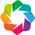

In [6]:

from autoviz.AutoViz_Class import AutoViz_Class
AV = AutoViz_Class()

In [7]:
%matplotlib inline

Para mayor visualizacion le voy a sacar la descripcion a los inmuebles

In [8]:
dataset_venta_plot = dataset_venta.drop(columns=["description"])

In [9]:
dft = AV.AutoViz(
    filename="",
    sep=",",
    depVar="dolar_price",
    dfte=dataset_venta_plot,
    header=0,
    verbose=2,
    lowess=False,
    chart_format="bokeh",
    max_rows_analyzed=6000,
    max_cols_analyzed=24,
)

    Since nrows is smaller than dataset, loading random sample of 6000 rows into pandas...
Shape of your Data Set loaded: (6000, 23)
#######################################################################################
######################## C L A S S I F Y I N G  V A R I A B L E S  ####################
#######################################################################################
Classifying variables in data set...
  Printing upto 30 columns max in each category:
    Numeric Columns : ['lat', 'lon', 'rooms', 'bedrooms', 'surface_total', 'surface_covered', 'price', 'bathrooms']
    Integer-Categorical Columns: []
    String-Categorical Columns: ['l1', 'l2', 'property_type']
    Factor-Categorical Columns: []
    String-Boolean Columns: ['currency']
    Numeric-Boolean Columns: []
    Discrete String Columns: ['start_date', 'end_date', 'created_on', 'l3', 'l4']
    NLP text Columns: ['title']
    Date Time Columns: []
    ID Columns: ['id']
    Columns that will not be con

Column
    [0] Row
        [0] HoloViews(DynamicMap)
        [1] Column
            [0] WidgetBox
                [0] Select(margin=(20, 20, 20, 20), options=['lat', 'lon', ...], value='lat', width=250)
            [1] VSpacer()

Row
    [0] WidgetBox
        [0] Select(name='X-Axis', options=['lat', 'lon', ...], value='lat')
        [1] Select(name='Y-Axis', options=['lat', 'lon', ...], value='lon')
        [2] Select(name='Color', options=['None', 'dolar_price'], value='None')
    [1] ParamFunction(function)

Column
    [0] Row
        [0] HoloViews(DynamicMap)
        [1] Column
            [0] WidgetBox
                [0] Select(margin=(20, 20, 20, 20), options=['l1', 'l2', 'property_typ...], value='l1', width=250)
            [1] VSpacer()

Column
    [0] Row
        [0] HoloViews(DynamicMap)
        [1] Column
            [0] WidgetBox
                [0] Select(margin=(20, 20, 20, 20), options=['lon', 'rooms', ...], value='lon', width=250)
            [1] VSpacer()

HoloViews(DynamicMap)

HoloViews(Violin)

HoloViews(Overlay)

Row
    [0] WidgetBox
        [0] Select(name='X-Axis', options=['l1', 'l2', 'property_typ...], value='l1')
        [1] Select(name='Y-Axis', options=['lat', 'lon', ...], value='lat')
    [1] ParamFunction(function)

Time to run AutoViz (in seconds) = 2


#### Resumen de observaciones

##### Scatter plot  vs dolar_price

- Surface_ total : se ve que hay outlier (hipótesis asociado al tipo de inmueble) (ídem superficie cubierta)
- Room : para las distintas cantidades de cuartos hay rangos de precios (ídem bathrooms)
- Bedrooms: se ven outliers, concentrado en menor a 10



##### Scatter 2 variables y densidad dolar_price

- Latitud y longitud 

=> outlier, mal catalogados en el dataset, supuestamente es de argentina únicamente y tiene datos de Estados  , Unidos, de brasil. 

=> concentración de precios

- Superficie total y superficie cubierta 

=> outlier, hay inmuebles con gran cantidad de superficie no cubierta


##### Categorical variable (ULTIMO grafico)

- property type y dolar_price: caro depósitos, otro, casa
- propery_type y surface_total => casa de campo, lote y depósitos son las mas grandes
-  property type y surface covered => top 2 deposito y lote
- Currency => una moneda preponderante
- L1 => nos muestra que hay datos de 4 países, y solo debería haber de 1

##### Heatmap

- dolar_price y surface_total => no tan relevante
- dolar_price y surface_covered => no tan relevante
- dolar_price y rooms, bedrooms, bathrooms => mas importante

- observar diferencia con price 

### Alquiler

In [12]:
dataset_alquiler = dataset_cleaned[dataset_cleaned["operation_type"] != "Venta"]

In [13]:
dataset_alquiler.describe()

,lat,lon,rooms,bedrooms,bathrooms,surface_total,surface_covered,price,dolar_price
count,212403.000000,212399.000000,173716.000000,150179.000000,199491.000000,117326.000000,1.290590e+05,2.338810e+05,2.338810e+05
mean,-34.404403,-59.382718,2.624030,1.880822,1.621271,312.202155,1.781844e+04,4.498967e+04,1.609159e+03
std,2.330799,2.551865,1.666824,1.502919,1.091707,2176.542690,5.985786e+06,1.334187e+05,6.505322e+03
min,-54.827686,-121.768389,1.000000,-1.000000,1.000000,-136.000000,-1.300000e+02,0.000000e+00,0.000000e+00
25%,-34.655701,-58.719096,2.000000,1.000000,1.000000,43.000000,4.000000e+01,1.250000e+04,2.188450e+02
50%,-34.589554,-58.470183,2.000000,2.000000,1.000000,70.000000,6.500000e+01,2.200000e+04,3.636360e+02
75%,-34.454674,-58.394552,3.000000,3.000000,2.000000,182.000000,1.700000e+02,3.950000e+04,9.990000e+02
max,42.443426,58.703066,35.000000,129.000000,20.000000,200000.000000,2.147484e+09,8.800000e+06,1.850000e+06


In [14]:
dataset_alquiler.quantile([.1, .5, .75, .80, .90])

,lat,lon,rooms,bedrooms,bathrooms,surface_total,surface_covered,price,dolar_price
0.10,-34.951569,-64.181761,1.0,1.0,1.0,34.0,32.0,3500.0,153.333
0.50,-34.589554,-58.470183,2.0,2.0,1.0,70.0,65.0,22000.0,363.636
0.75,-34.454674,-58.394552,3.0,3.0,2.0,182.0,170.0,39500.0,999.000
0.80,-34.405831,-58.382843,4.0,3.0,2.0,237.0,210.0,45000.0,1472.000
0.90,-31.595311,-58.023449,5.0,4.0,3.0,460.0,350.0,80000.0,3500.000


In [15]:
dataset_alquiler_plot = dataset_alquiler.drop(columns=["description"])

In [17]:
dft_alquiler = AV.AutoViz(
    filename="",
    sep=",",
    depVar="dolar_price",
    dfte=dataset_alquiler_plot,
    header=0,
    verbose=0,
    lowess=False,
    chart_format="html",
    max_rows_analyzed=6000,
    max_cols_analyzed=24,
)

    Since nrows is smaller than dataset, loading random sample of 6000 rows into pandas...
Shape of your Data Set loaded: (6000, 23)
#######################################################################################
######################## C L A S S I F Y I N G  V A R I A B L E S  ####################
#######################################################################################
Classifying variables in data set...
    22 Predictors classified...
        3 variables removed since they were ID or low-information variables
Since Number of Rows in data 6000 exceeds maximum, randomly sampling 6000 rows for EDA...

################ Regression problem #####################
Saving scatterplots in HTML format
Saving pair_scatters in HTML format                                             
Saving distplots_cats in HTML format                                            
Saving distplots_nums in HTML format                                            
Saving kde_plots in HTML format

In [16]:
dft_alquiler = AV.AutoViz(
    filename="",
    sep=",",
    depVar="dolar_price",
    dfte=dataset_alquiler_plot,
    header=0,
    verbose=0,
    lowess=False,
    chart_format="bokeh",
    max_rows_analyzed=6000,
    max_cols_analyzed=24,
)

    max_rows_analyzed is smaller than dataset shape 952411...
        randomly sampled 6000 rows from read CSV file
Shape of your Data Set loaded: (6000, 24)
#######################################################################################
######################## C L A S S I F Y I N G  V A R I A B L E S  ####################
#######################################################################################
Classifying variables in data set...
    23 Predictors classified...
        2 variables removed since they were ID or low-information variables
Since Number of Rows in data 6000 exceeds maximum, randomly sampling 6000 rows for EDA...

################ Regression problem #####################


Column
    [0] Row
        [0] HoloViews(DynamicMap)
        [1] Column
            [0] WidgetBox
                [0] Select(margin=(20, 20, 20, 20), options=['lat', 'lon', ...], value='lat', width=250)
            [1] VSpacer()

Row
    [0] WidgetBox
        [0] Select(name='X-Axis', options=['lat', 'lon', ...], value='lat')
        [1] Select(name='Y-Axis', options=['lat', 'lon', ...], value='lon')
        [2] Select(name='Color', options=['None', 'dolar_price'], value='None')
    [1] ParamFunction(function)

Column
    [0] Row
        [0] HoloViews(DynamicMap)
        [1] Column
            [0] WidgetBox
                [0] Select(margin=(20, 20, 20, 20), options=['l1', 'property_type', ...], value='l1', width=250)
            [1] VSpacer()

Column
    [0] Row
        [0] HoloViews(DynamicMap)
        [1] Column
            [0] WidgetBox
                [0] Select(margin=(20, 20, 20, 20), options=['rooms', 'bathrooms', ...], value='rooms', width=250)
            [1] VSpacer()

HoloViews(DynamicMap)

HoloViews(Violin)

HoloViews(Overlay)

Row
    [0] WidgetBox
        [0] Select(name='X-Axis', options=['l1', 'property_type', ...], value='l1')
        [1] Select(name='Y-Axis', options=['lat', 'lon', ...], value='lat')
    [1] ParamFunction(function)

Time to run AutoViz (in seconds) = 13


#### Resumen de observaciones

##### Scatter plot  vs dolar_price

- Surface_ total : se ve que hay outlier (hipótesis asociado al tipo de inmueble) (ídem superficie cubierta) (menor que los de ventas la cantidad)
- Room : para las distintas cantidades de cuartos hay rangos de precios (ídem bathrooms)
- Bedrooms: se ven outliers, concentrado en menor a 10

similar a ventas

##### Scatter 2 variables y densidad dolar_price

- Latitud y longitud 

=> gran cantidad en uruguay

- Superficie total y superficie cubierta 

=> menor cantidad de outliers, bastante lineal


##### Categorical variable (ULTIMO grafico)

- property type y dolar_price: caro depósitos. Pero luego el resto bastante parejo
- propery_type y surface_total => casa de campo, otros y depósitos son las mas grandes
-  property type y surface covered => top 2 deposito y otro
- Currency => una moneda preponderante
- L1 => nos muestra que hay datos de 3 países, y gran presencia de uruguay

##### Heatmap

- dolar_price y surface_total
- dolar_price y surface_covered => es el mas importante a diferencia de venta
- dolar_price y rooms, bedrooms, bathrooms => no tan relevante

- observar diferencia con price 

## Outliers

### Ventas

Existen:

- Rooms con +25
- Bedrooms con +30
- Bathroom con + 15
- surface_total con +60000


In [16]:
rooms_outliers = dataset_venta.query("rooms>=25")
bedrooms_outliers = dataset_venta.query("bedrooms>=30")
bathrooms_outliers = dataset_venta.query("bathrooms>=15")
surface_total_outliers = dataset_venta.query("surface_total>=60000")

##### Mas de 25 rooms

In [17]:
rooms_outliers[["property_type", "l1", "l2", "rooms", "bedrooms", "bathrooms","surface_total"]].describe()

,rooms,bedrooms,bathrooms,surface_total
count,106.000000,84.000000,68.000000,62.000000
mean,29.433962,15.166667,7.661765,984.741935
std,4.329344,14.118119,4.628305,1158.449005
min,25.000000,0.000000,1.000000,31.000000
25%,25.000000,1.750000,4.750000,501.000000
50%,30.000000,14.500000,8.500000,845.000000
75%,31.750000,27.000000,10.000000,1000.000000
max,40.000000,74.000000,19.000000,6834.000000


In [18]:
rooms_outliers["property_type"].value_counts()

Otro               32
Casa               32
Local comercial    16
Departamento       11
PH                  6
Oficina             5
Lote                4
Name: property_type, dtype: int64

In [23]:
f"representa un {round(rooms_outliers['id'].count() * 100/dataset_venta['id'].count(),3)}% del dataset de ventas" 

'representa un 0.015% del dataset de ventas'

**Observacion**: estos inmuebles con muchas habitaciones varios caen en la categoria property type "Otros" y luego hay casas muy grandes. Tambien suelen tener superficie muy grande. 

##### Mas de 30 bedrooms

In [177]:
bedrooms_outliers[["property_type", "l1", "l2", "rooms", "bedrooms", "bathrooms","surface_total"]].describe()

,rooms,bedrooms,bathrooms,surface_total
count,33.000000,110.000000,28.000000,74.000000
mean,16.636364,63.036364,4.107143,2521.432432
std,16.042557,86.942133,4.848362,5775.874913
min,1.000000,30.000000,1.000000,30.000000
25%,4.000000,32.250000,1.000000,700.000000
50%,6.000000,40.500000,2.000000,1277.500000
75%,35.000000,69.000000,3.500000,2500.000000
max,40.000000,900.000000,20.000000,47500.000000


In [178]:
bedrooms_outliers["property_type"].value_counts()

Otro               60
Departamento       17
Local comercial    12
Casa               11
PH                  5
Oficina             3
Lote                2
Name: property_type, dtype: int64

In [24]:
f"representa un {round(bedrooms_outliers['id'].count() * 100/dataset_venta['id'].count(),3)}% del dataset de ventas" 

'representa un 0.015% del dataset de ventas'

**Observacion**: la mayoria de estos inmuebles caen en la categoria property type "Otros". Parece raro que haya datos donde tiene mas de 30 bedrooms pero figuren 1 room o 1 bathrooms. Tambien que la superficie total se 30 metros cuadrados para 30 bedrooms no tiene mucho sentido.

##### Mas de 15 bathrooms

In [179]:
bathrooms_outliers[["property_type", "l1", "l2", "rooms", "bedrooms", "bathrooms","surface_total"]].describe()

,rooms,bedrooms,bathrooms,surface_total
count,47.000000,61.000000,84.000000,55.000000
mean,14.276596,14.311475,17.559524,1374.763636
std,8.614200,6.751644,1.839010,1595.984057
min,1.000000,0.000000,15.000000,170.000000
25%,6.500000,13.000000,16.000000,685.500000
50%,16.000000,16.000000,18.000000,886.000000
75%,20.000000,17.000000,19.250000,1450.000000
max,30.000000,41.000000,20.000000,11236.000000


In [180]:
bathrooms_outliers["property_type"].value_counts()

Otro               36
Casa               16
Oficina            13
Local comercial    12
Departamento        4
PH                  2
Lote                1
Name: property_type, dtype: int64

In [25]:
f"representa un {round(bathrooms_outliers['id'].count() * 100/dataset_venta['id'].count(),3)}% del dataset de ventas" 

'representa un 0.012% del dataset de ventas'

**Observacion**: Existe un inmueble que tiene 15 bathrooms pero no tiene bedrooms. Luego existe otro inmueble que tiene 15 bathrooms y tiene una sola room. La mayoria cae en property type "Otro"

##### Mas de 60000 surface total

In [181]:
surface_total_outliers[["property_type", "l1", "l2", "rooms", "bedrooms", "bathrooms","surface_total"]].describe()

,rooms,bedrooms,bathrooms,surface_total
count,121.000000,89.000000,110.000000,428.000000
mean,4.123967,2.685393,2.063636,106423.717290
std,2.899915,1.466253,1.460660,37894.305402
min,1.000000,1.000000,1.000000,60000.000000
25%,3.000000,2.000000,1.000000,77631.500000
50%,4.000000,2.000000,1.500000,98000.000000
75%,5.000000,3.000000,3.000000,130885.250000
max,22.000000,10.000000,8.000000,200000.000000


In [182]:
surface_total_outliers["property_type"].value_counts()

Lote               191
Otro               149
Casa                40
Departamento        19
Casa de campo       14
Local comercial     10
PH                   3
Depósito             2
Name: property_type, dtype: int64

In [26]:
f"representa un {round(surface_total_outliers['id'].count() * 100/dataset_venta['id'].count(),3)}% del dataset de ventas" 

'representa un 0.06% del dataset de ventas'

**Observacion**: La mayoria cae en property type "Lote" pero hay varios en "Otro". La mayoria no tiene tantas habitaciones, ni bedrooms, ni bathrooms.

### Alquiler

Existen:

- Rooms con +25
- Bedroom con +15
- Superficie total con + 40000

In [27]:
rooms_outliers_alquiler = dataset_alquiler.query("rooms>=25")
bedrooms_outliers_alquiler = dataset_alquiler.query("bedrooms>=15")
surface_total_outliers_alquiler = dataset_alquiler.query("surface_total>=40000")

##### Mas de 25 rooms

In [184]:
rooms_outliers_alquiler[["property_type", "l1", "l2", "rooms", "bedrooms", "bathrooms","surface_total"]].describe()

,rooms,bedrooms,bathrooms,surface_total
count,64.00000,48.000000,13.000000,13.000000
mean,28.93750,3.708333,7.153846,1039.538462
std,1.94263,9.410176,4.845034,490.813375
min,25.00000,0.000000,1.000000,58.000000
25%,29.00000,0.000000,4.000000,792.000000
50%,29.00000,0.000000,6.000000,1000.000000
75%,29.00000,0.000000,9.000000,1200.000000
max,35.00000,30.000000,15.000000,2000.000000


In [185]:
rooms_outliers_alquiler["property_type"].value_counts()

Otro               43
Oficina             9
Local comercial     6
Casa                3
PH                  2
Departamento        1
Name: property_type, dtype: int64

In [28]:
f"representa un {round(rooms_outliers_alquiler['id'].count() * 100/dataset_alquiler['id'].count(),3)}% del dataset de ventas" 

'representa un 0.027% del dataset de ventas'

**Observacion** : la mayoria tiene 0 bedrooms y pocos bathrooms. La mayoria en property type "Otro".

##### Mas de 15 bedrooms

In [186]:
bedrooms_outliers_alquiler[["property_type", "l1", "l2", "rooms", "bedrooms", "bathrooms","surface_total"]].describe()

,rooms,bedrooms,bathrooms,surface_total
count,28.000000,61.000000,29.000000,27.000000
mean,15.428571,35.540984,7.793103,975.148148
std,11.100312,25.655132,6.919844,908.622995
min,1.000000,16.000000,1.000000,65.000000
25%,3.750000,20.000000,3.000000,513.000000
50%,18.000000,24.000000,4.000000,1000.000000
75%,22.250000,41.000000,16.000000,1200.000000
max,35.000000,129.000000,20.000000,5000.000000


In [187]:
bedrooms_outliers_alquiler["property_type"].value_counts()

Casa               18
Otro               16
Local comercial    11
PH                  6
Departamento        6
Oficina             4
Name: property_type, dtype: int64

In [29]:
f"representa un {round(bedrooms_outliers_alquiler['id'].count() * 100/dataset_alquiler['id'].count(),3)}% del dataset de ventas" 

'representa un 0.026% del dataset de ventas'

**Observacion** : Hay un inmueble que tiene mas de 15 bedrooom y 1 room, tambien hay. otra que tiene 15 bedroom y 1 bathroom. La cantidad de bedrooms es mayor considerablemente a la cantidad de room y bathroom.  Hay varios en property type "Otro".

##### Mas de 40000 surface total

In [188]:
surface_total_outliers_alquiler[["property_type", "l1", "l2", "rooms", "bedrooms", "bathrooms","surface_total"]].describe()

,rooms,bedrooms,bathrooms,surface_total
count,24.000000,24.000000,32.000000,46.000000
mean,4.541667,3.666667,3.031250,80021.130435
std,1.744037,1.809796,1.555103,41255.966288
min,1.000000,1.000000,1.000000,40000.000000
25%,3.750000,2.750000,2.000000,50000.000000
50%,4.500000,3.000000,2.500000,64546.500000
75%,5.000000,5.000000,4.000000,86750.000000
max,9.000000,9.000000,6.000000,200000.000000


In [189]:
surface_total_outliers_alquiler["property_type"].value_counts()

Casa             21
Otro             15
Casa de campo     4
Departamento      2
Lote              2
Depósito          2
Name: property_type, dtype: int64

In [31]:
f"representa un {round(surface_total_outliers_alquiler['id'].count() * 100/dataset_alquiler['id'].count(),3)}% del dataset de ventas" 

'representa un 0.02% del dataset de ventas'

**Observacion** : La cantidad de metros cuadrados de superficie total para la cantidad de tipos de habitaciones es considerablemente alta. Hay varios en property type "Otro".

### ¿Que es el property type "Otro"?

#### Venta

In [41]:
f"Otro representa el {round(dataset_venta['property_type'].value_counts()['Otro'] * 100/ dataset_venta['id'].count(), 2)}% del dataset de ventas"

'Otro representa el 2.57% del dataset de ventas'

In [43]:
dataset_venta_otro = dataset_venta[dataset_venta['property_type'] == "Otro"]

In [44]:
dataset_venta_otro.describe()

,lat,lon,rooms,bedrooms,bathrooms,surface_total,surface_covered,price,dolar_price
count,16639.000000,16638.000000,7627.000000,6290.000000,7184.000000,5158.000000,5.477000e+03,1.848600e+04,1.848600e+04
mean,-34.323706,-59.702545,3.329225,2.532909,2.608575,5294.077356,4.609100e+05,1.070694e+06,5.841668e+05
std,3.974282,3.970938,3.289277,5.657440,2.208766,20523.866351,2.908149e+07,1.111422e+07,1.409176e+06
min,-54.831678,-81.714912,1.000000,0.000000,1.000000,10.000000,-3.000000e+00,0.000000e+00,0.000000e+00
25%,-34.920489,-59.676762,1.000000,0.000000,1.000000,176.000000,1.500000e+02,1.200000e+05,1.062690e+05
50%,-34.556573,-58.665814,3.000000,2.000000,2.000000,400.000000,3.000000e+02,2.600000e+05,2.450000e+05
75%,-34.332028,-58.382886,4.000000,3.000000,3.000000,1200.000000,7.200000e+02,6.200000e+05,5.500000e+05
max,43.318334,-1.981231,40.000000,101.000000,20.000000,200000.000000,2.147484e+09,1.111111e+09,5.000000e+07


**Observaciones**: 
- Min surface_covered es negativa
- 25% de otro no tiene habitaciones
- 75% de los inmuebles tiene mas de 176 metros cuadrados (grandes)
- En los maximos se puede ver que hay outliers

In [48]:
dataset_venta_otro.title.map(lambda title: len(title)).describe()

count    18486.000000
mean        45.612247
std         20.539490
min          4.000000
25%         30.000000
50%         46.000000
75%         59.000000
max        198.000000
Name: title, dtype: float64

In [49]:
dataset_venta_otro.title.map(lambda title: len(title)).quantile([.1, .5, .75, .80, .90])

0.10    17.0
0.50    46.0
0.75    59.0
0.80    63.0
0.90    72.0
Name: title, dtype: float64

##### Analisis de titulos

In [217]:
from sklearn.feature_extraction.text import CountVectorizer

In [218]:
import nltk

In [61]:
nltk.download()

showing info https://raw.githubusercontent.com/nltk/nltk_data/gh-pages/index.xml


True

In [219]:
stopword_es = nltk.corpus.stopwords.words('spanish')

In [194]:
titles = dataset_venta_otro.title

###### Filtro stopwords

In [195]:
text_without_stop_words = titles.map(lambda title: " ".join([word for word in title.split(" ") if not (word in stopword_es)]))

###### Filtro numeros y unidades

In [174]:
def has_digit(word):
    for c in word:
        if c.isdigit():
            return True
    return False

In [196]:
text_without_stop_words = text_without_stop_words.map(lambda title: " ".join([word for word in title.split(" ") if not has_digit(word) ]))

In [197]:
count_vect = CountVectorizer()
count_matrix = count_vect.fit_transform(text_without_stop_words)
count_array = count_matrix.toarray()
sum_words = count_matrix.sum(axis=0) 
words_freq = [(word, sum_words[0, idx]) for word, idx in count_vect.vocabulary_.items()]
words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
top_40_words = [(word, count) for word, count in words_freq[:40] if not word in stopword_es]
words = []
freqs = []

for word, freq_i in top_40_words:
    words.append(word)
    freqs.append(freq_i)

Text(0, 0.5, 'Palabras')

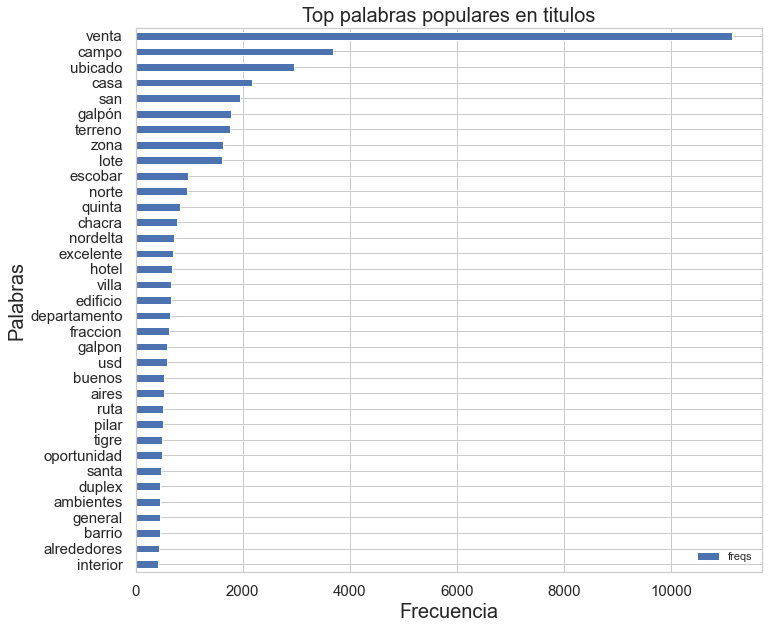

In [198]:
plt = pd.DataFrame({"words": words[::-1], "freqs":freqs[::-1]}).plot.barh(x='words', y='freqs', figsize=(10, 10),fontsize=15)
plt.set_title('Top palabras populares en titulos', fontsize=20)
plt.set_xlabel('Frecuencia', fontsize=20)
plt.set_ylabel('Palabras', fontsize=20)



#### Alquiler 

In [42]:
f"Otro representa el {round(dataset_alquiler['property_type'].value_counts()['Otro'] * 100/ dataset_alquiler['id'].count(),2)}% del dataset de alquler"

'Otro representa el 2.63% del dataset de alquler'

In [45]:
dataset_alquiler_otro = dataset_alquiler[dataset_alquiler['property_type'] == "Otro"]

In [46]:
dataset_alquiler_otro.describe()

,lat,lon,rooms,bedrooms,bathrooms,surface_total,surface_covered,price,dolar_price
count,5738.000000,5738.000000,2202.000000,1250.000000,3130.000000,3080.000000,3.389000e+03,6.161000e+03,6161.000000
mean,-34.379196,-59.436092,4.321072,2.825600,2.390735,2417.682143,4.475962e+03,1.784862e+05,4473.220241
std,2.067309,2.535211,4.211471,4.275349,1.507532,8638.091488,1.718254e+05,4.498619e+05,9806.781013
min,-54.801910,-96.857883,1.000000,0.000000,1.000000,10.000000,1.000000e+00,1.000000e+00,0.011000
25%,-34.664083,-58.862801,2.000000,1.000000,1.000000,277.000000,2.100000e+02,1.120000e+04,578.778000
50%,-34.559625,-58.625366,4.000000,2.000000,2.000000,620.000000,5.000000e+02,4.900000e+04,1500.000000
75%,-34.407891,-58.440856,5.000000,3.000000,3.000000,1800.000000,1.500000e+03,1.500000e+05,4000.000000
max,20.311282,-54.596577,29.000000,62.000000,18.000000,200000.000000,1.000000e+07,8.800000e+06,180000.000000


**Observaciones**: 
- 75% de los inmuebles tiene mas de 277 metros cuadrados (grandes)
- En los maximos se puede ver que hay outliers

In [50]:
dataset_alquiler_otro.title.map(lambda title: len(title)).describe()

count    6161.000000
mean       46.388249
std        22.161396
min         4.000000
25%        27.000000
50%        46.000000
75%        61.000000
max       237.000000
Name: title, dtype: float64

In [52]:
dataset_alquiler_otro.title.map(lambda title: len(title)).quantile([.1, .5, .75, .80, .90])

0.10    18.0
0.50    46.0
0.75    61.0
0.80    65.0
0.90    74.0
Name: title, dtype: float64

##### Analisis de titulos

In [199]:
titles = dataset_alquiler_otro.title

In [200]:
text_without_stop_words = titles.map(lambda title: " ".join([word for word in title.split(" ") if not (word in stopword_es)]))

In [201]:
text_without_stop_words = text_without_stop_words.map(lambda title: " ".join([word for word in title.split(" ") if not has_digit(word) ]))

In [202]:
count_vect = CountVectorizer()
count_matrix = count_vect.fit_transform(text_without_stop_words)
count_array = count_matrix.toarray()
sum_words = count_matrix.sum(axis=0) 
words_freq = [(word, sum_words[0, idx]) for word, idx in count_vect.vocabulary_.items()]
words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
top_40_words = [(word, count) for word, count in words_freq[:40] if not word in stopword_es]
words = []
freqs = []

for word, freq_i in top_40_words:
    words.append(word)
    freqs.append(freq_i)

Text(0, 0.5, 'Palabras')

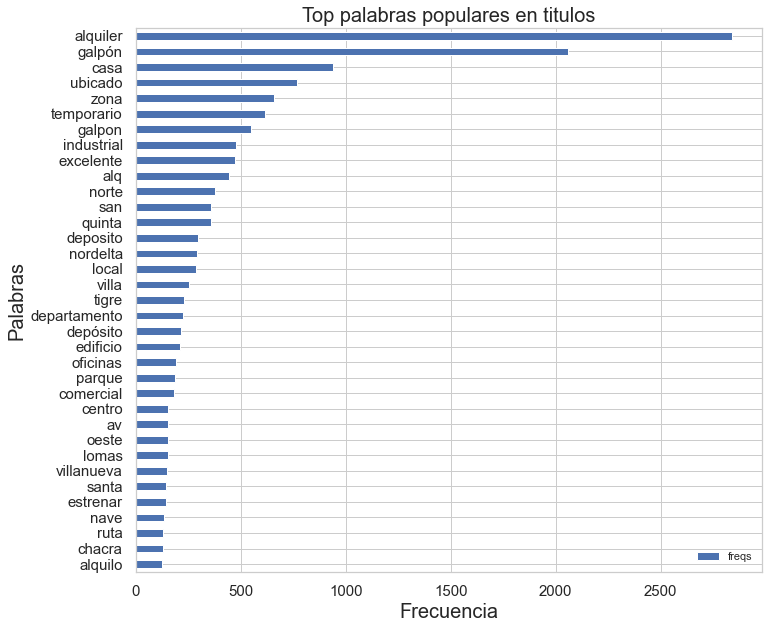

In [203]:
plt = pd.DataFrame({"words": words[::-1], "freqs":freqs[::-1]}).plot.barh(x='words', y='freqs', figsize=(10, 10),fontsize=15)
plt.set_title('Top palabras populares en titulos', fontsize=20)
plt.set_xlabel('Frecuencia', fontsize=20)
plt.set_ylabel('Palabras', fontsize=20)



#### Inmueble en venta 

In [215]:
deptos_venta = dataset_venta[dataset_venta["property_type"] == "Departamento"][["title","description"]]

In [216]:
titles = deptos_venta.title

In [220]:
text_without_stop_words = titles.map(lambda title: " ".join([word for word in title.split(" ") if not (word in stopword_es)]))

In [221]:
def has_digit(word):
    for c in word:
        if c.isdigit():
            return True
    return False

In [222]:
text_without_stop_words = text_without_stop_words.map(lambda title: " ".join([word for word in title.split(" ") if not has_digit(word) ]))

In [223]:
count_vect = CountVectorizer()
count_matrix = count_vect.fit_transform(text_without_stop_words)
count_array = count_matrix.toarray()
sum_words = count_matrix.sum(axis=0) 
words_freq = [(word, sum_words[0, idx]) for word, idx in count_vect.vocabulary_.items()]
words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
top_40_words = [(word, count) for word, count in words_freq[:40] if not word in stopword_es]
words = []
freqs = []

for word, freq_i in top_40_words:
    words.append(word)
    freqs.append(freq_i)

Text(0, 0.5, 'Palabras')

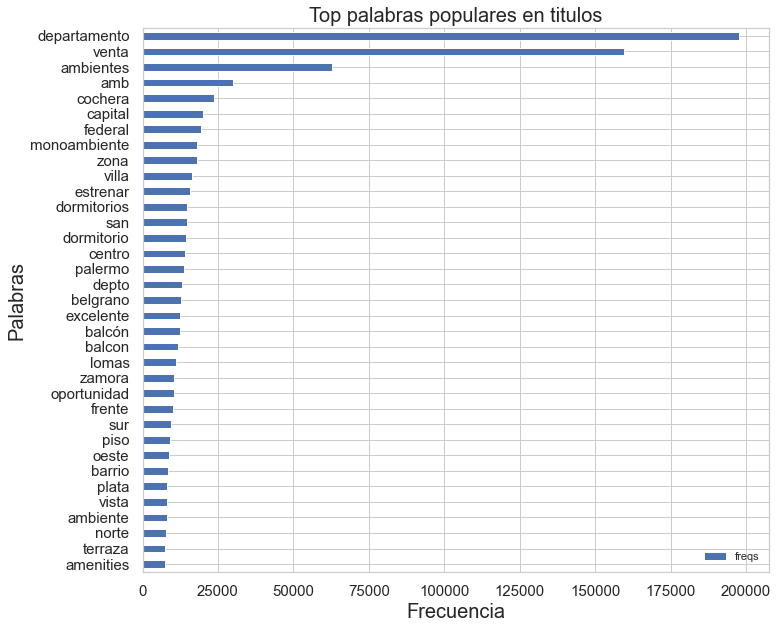

In [224]:
plt = pd.DataFrame({"words": words[::-1], "freqs":freqs[::-1]}).plot.barh(x='words', y='freqs', figsize=(10, 10),fontsize=15)
plt.set_title('Top palabras populares en titulos', fontsize=20)
plt.set_xlabel('Frecuencia', fontsize=20)
plt.set_ylabel('Palabras', fontsize=20)


In [226]:
descriptions = deptos_venta.description

In [232]:
descriptions = descriptions[descriptions.map(lambda desc: type(desc) != float)]

In [233]:
text_without_stop_words = descriptions.map(lambda title: " ".join([word for word in title.split(" ") if not (word in stopword_es)]))

In [234]:
text_without_stop_words = text_without_stop_words.map(lambda title: " ".join([word for word in title.split(" ") if not has_digit(word) ]))

In [235]:
count_vect = CountVectorizer()
count_matrix = count_vect.fit_transform(text_without_stop_words)
count_array = count_matrix.toarray()
sum_words = count_matrix.sum(axis=0) 
words_freq = [(word, sum_words[0, idx]) for word, idx in count_vect.vocabulary_.items()]
words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
top_40_words = [(word, count) for word, count in words_freq[:40] if not word in stopword_es]
words = []
freqs = []

for word, freq_i in top_40_words:
    words.append(word)
    freqs.append(freq_i)

Text(0, 0.5, 'Palabras')

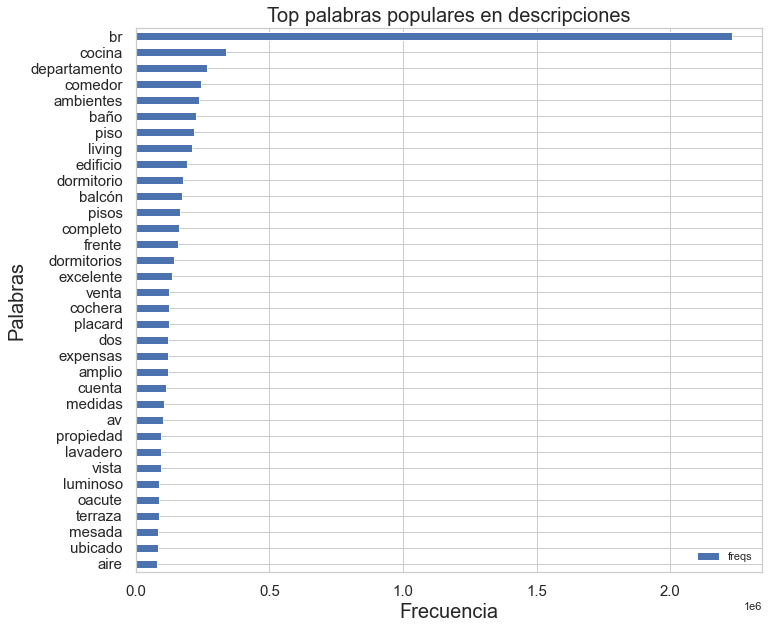

In [236]:
plt = pd.DataFrame({"words": words[::-1], "freqs":freqs[::-1]}).plot.barh(x='words', y='freqs', figsize=(10, 10),fontsize=15)
plt.set_title('Top palabras populares en descripciones', fontsize=20)
plt.set_xlabel('Frecuencia', fontsize=20)
plt.set_ylabel('Palabras', fontsize=20)
